In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle

import pathlib 
import os
import pickle
import torch

import PT_files.save_load as sl
from PT_files.afterburner_torch import afterburner, full_img_pass
from PT_files.model import DnCNN_B
from DnCNN_NP.layers_np import relu, np_BatchNorm2d, np_Conv2d
from DnCNN_NP.model_np import np_DnCNN
from DnCNN_NP.np_afterburner import np_full_img_pass

from skimage.metrics import peak_signal_noise_ratio, structural_similarity, mean_squared_error
import time 
import pdb

Using cuda device


**Work to be done:**

1. Compare values of `torch_afterburner`, `denoised_2k`, `np_denoised_2k` to see if that doing a single full pass without overlapping inference regions creates artifacts, as well as, noticeable quality degradation
2. See full FVC image residuals
    - Want to make sure that the whole image isn't having positive values, but rather variations. Ideally, we'd want the residuals to be white (ie. there is no difference between torch/numpy or torch/truth & numpy/truth). 
        - Willing to have some variations of low/high values within the denoised image.
3. Send some residual plots to david of the whole FVC image residuals

Load weights, data, numpy im2col index matrices, numpy layer lists (used in the for loop construction of the model), and create a single input sample for testing

In [2]:
# Loading data & weights dictionary

# Create path to model parameters
PATH = pathlib.Path(os.getenv('PSCRATCH'))
DATA = PATH / 'DESI_dn' /'Model_params'
assert DATA.exists()

# Load the trained model parameters
name = '2k_model_bs64_e800_ps50_Adam.pth'
weights = torch.load(str(DATA / name))


#Load the actual data that we're working on & print the shape of this data
test_data = sl.NERSC_load('test_data_40%_6000.npy')
sample = test_data[0]
print('Shape of test set=', sample.shape)

# Create single sample to replicate what the input will look like when working
# the FVC pipeline
samp_6k = sample[0]
samp_6k = np.reshape(samp_6k, (1, 1, 6000, 6000))

# Load the saved im2col matrices of indices & im2col layer lists
im2col_mat = sl.NERSC_load(name='im2col_layer_dict_2k.pkl')
im2col_layer_list = sl.NERSC_load(name='2k_NP_layers_list.pkl')

Shape of test set= (108, 1, 6000, 6000)


Change `afterburner` to run on single example (ie. for use on FVC image per day) as well as get rid of the `print` output it gives when ran

In [3]:
%timeit torch_afterburner = afterburner(dataset=test_data, model=DnCNN_B,  model_params='2k_model_bs64_e800_ps50_Adam.pth', samp_idx=0) 

11.2 s ± 50.1 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [4]:
def calc_base_metrics(test_set, idx):
    """
    Calculate PSNR & SSIM of the base noisy/clean pair
    """
    # idx the specific sample within the tuple that contains the noisy/clean 
    # pair
    noise = test_set[0][idx][0]
    clean = test_set[1][idx][0]
    
    # Calculate PSNR & SSIM using skimage.metrics
    base_psnr = peak_signal_noise_ratio(image_true=clean, image_test=noise)
    base_ssim = structural_similarity(im1=clean, im2=noise)
    
    return base_psnr, base_ssim

In [5]:
base_psnr, base_ssim = calc_base_metrics(test_set=test_data, idx=0)

In [6]:
def calculate_metrics(dncnn_out_idx, test_set):
    """
    Calculates the PSNR/SSIM metrics for both the base noisy/clean pairs,
    as well as, the PSNR/SSIM metrics for the denoised image and the clean image
    """
    
    # Calculate the
    base_psnr, base_ssim = calc_base_metrics(test_set=test_set, idx=dncnn_out_idx)
    print('Base PSNR = ', base_psnr) # Higher is better units are in db
    print('Base SSIM = ', base_ssim) #higher is better
    
    dncnn_out = afterburner(dataset=test_set, model=DnCNN_B, model_params='2k_model_bs64_e800_ps50_Adam.pth', samp_idx=dncnn_out_idx)
    psnr_new = peak_signal_noise_ratio(image_true=test_set[1][dncnn_out_idx][0], image_test=dncnn_out[0][0])
    print('Denoised PSNR = ', psnr_new) # Higher is better units are in db
    ssim_new = structural_similarity(im1=test_set[1][dncnn_out_idx][0], im2=dncnn_out[0][0])
    print('Denoised SSIM = ', ssim_new) #higher is better
    

    return (psnr_new, ssim_new), (base_psnr, base_ssim)

In [7]:
new_metrics, old_metrics = calculate_metrics(dncnn_out_idx=0, test_set=test_data)

Base PSNR =  29.08573242225801
Base SSIM =  0.8394828830475777


/tmp/ipykernel_29283/3950312753.py:13: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  psnr_new = peak_signal_noise_ratio(image_true=test_set[1][dncnn_out_idx][0], image_test=dncnn_out[0][0])
/global/homes/m/mdowicz/.local/perlmutter/pytorch1.9.0/lib/python3.8/site-packages/skimage/_shared/utils.py:348: UserWarning: Inputs have mismatched dtype.  Setting data_range based on im1.dtype.
  return func(*args, **kwargs)


Denoised PSNR =  40.85031359827865
Denoised SSIM =  0.9869217387060768


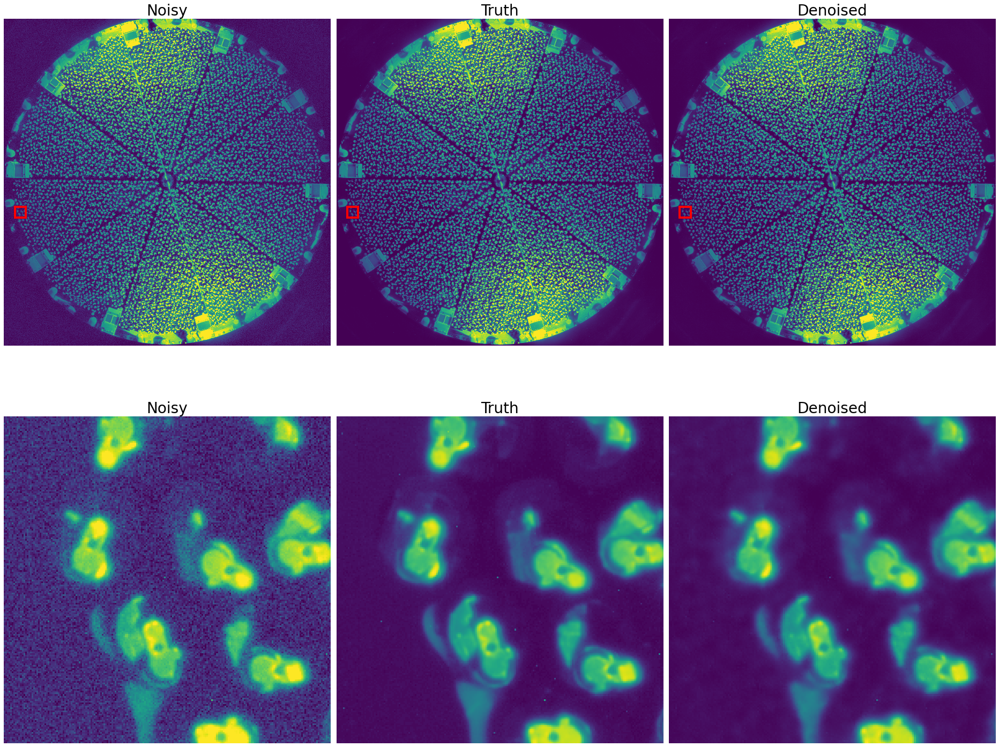

In [20]:
def afterburner_comparison(raw_data,
                    inf_data,
                    size,
                    x_start_idx,
                    y_start_idx):
    
    data_6k_raw = raw_data[0][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
    data_6k_truth = raw_data[1][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]

    full_img_inf = inf_data[0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
        
    
    fig, ax = plt.subplots(2, 3,figsize=(26, 22))
    
    # For 200x200 patches
    vmin, vmax = np.percentile(data_6k_raw, (1,99))
    # For full image
    vmin_full, vmax_full = np.percentile(raw_data[0][0][0], (1,99))

    # Visualizing the discontinuity in the denoised images
    rect1 = Rectangle((x_start_idx, y_start_idx), size, size, linewidth=4, edgecolor='r', facecolor='none')
    rect2 = Rectangle((x_start_idx, y_start_idx), size, size, linewidth=4, edgecolor='r', facecolor='none')
    rect3 = Rectangle((x_start_idx, y_start_idx), size, size, linewidth=4, edgecolor='r', facecolor='none')

    # Full FVC img
    ax[0,0].imshow(raw_data[0][0][0], vmin=vmin_full, vmax=vmax_full, origin='upper', interpolation='none')
    ax[0,0].add_patch(rect1)
    ax[0,0].axis('off')
    ax[0,0].set_title('Noisy',fontsize=28) 
    ax[0,1].imshow(raw_data[1][0][0], vmin=vmin_full, vmax=vmax_full, origin='upper', interpolation='none')
    ax[0,1].add_patch(rect2)
    ax[0,1].axis('off')
    ax[0,1].set_title('Truth',fontsize=28) 
    ax[0,2].imshow(inf_data[0][0], vmin=vmin_full, vmax=vmax_full, origin='upper', interpolation='none')
    ax[0,2].add_patch(rect3)
    ax[0,2].axis('off')
    ax[0,2].set_title('Denoised', fontsize=28)
   

    # 200x200 Patch FVC img
    ax[1,0].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    # ax[0,0].add_patch(rect1)
    ax[1,0].axis('off')
    ax[1,0].set_title('Noisy',fontsize=28) 
    ax[1,1].imshow(data_6k_truth, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    # ax[0,1].add_patch(rect2)
    ax[1,1].axis('off')
    ax[1,1].set_title('Truth',fontsize=28) 
    ax[1,2].imshow(full_img_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    # ax[0,2].add_patch(rect3)
    ax[1,2].axis('off')
    ax[1,2].set_title('Denoised', fontsize=28)
    

    fig.tight_layout()

afterburner_comparison(raw_data=test_data,
                inf_data=torch_afterburner,
                size=200,
                x_start_idx=200,
                y_start_idx=3450)

In [9]:
new_metrics, old_metrics = calculate_metrics(dncnn_out_idx=1, test_set=test_data)

Base PSNR =  29.12836636677095
Base SSIM =  0.8399649779984644


/tmp/ipykernel_105550/3109177637.py:7: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  psnr_new = peak_signal_noise_ratio(image_true=test_set[1][dncnn_out_idx][0], image_test=dncnn_out[0][0])


Denoised PSNR =  40.30761482028752
Denoised SSIM =  0.9861649956044825


In [10]:
new_metrics, old_metrics = calculate_metrics(dncnn_out_idx=2, test_set=test_data)

Base PSNR =  28.983083597321677
Base SSIM =  0.8381829088777705


/tmp/ipykernel_105550/3109177637.py:7: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  psnr_new = peak_signal_noise_ratio(image_true=test_set[1][dncnn_out_idx][0], image_test=dncnn_out[0][0])


Denoised PSNR =  38.94235166115137
Denoised SSIM =  0.9845231836249709


In [11]:
new_metrics, old_metrics = calculate_metrics(dncnn_out_idx=3, test_set=test_data)

Base PSNR =  28.948400451621694
Base SSIM =  0.8293359637509957


/tmp/ipykernel_105550/3109177637.py:7: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  psnr_new = peak_signal_noise_ratio(image_true=test_set[1][dncnn_out_idx][0], image_test=dncnn_out[0][0])


Denoised PSNR =  40.8522843113294
Denoised SSIM =  0.9842475213724261


In [15]:
torch_afterburner[0][0].dtype

dtype('float64')

In [17]:
'float32'

'float32'

# Code to create and save full image passes for numpy and pytorch, as well as, afterburner via pytorch

In [3]:
# # PyTorch afterburner function
# torch_afterburner = afterburner(dataset=test_data, model=DnCNN_B,  model_params='2k_model_bs64_e800_ps50_Adam.pth', samp_idx=0) 
# torch_denoised_2k = full_img_pass(dataset=test_data, model=DnCNN_B,  model_params='2k_model_bs64_e800_ps50_Adam.pth', samp_idx=0)
    

# # Numpy afterburner function (not using overlapping inference patches)
# np_denoised_2k, count = np_full_img_pass(dataset=samp_6k, 
#                                       model=np_DnCNN,
#                                       weights_dict=weights, 
#                                       layer_list=im2col_layer_list,
#                                       im2col_mat=im2col_mat)

# # Saving the data from the pytorch afterburner, pytorch full pass (no overlaps),
# # and numpy full pass (no overlaps)

# sl.NERSC_save(name='torch_afterburner_2k', data=torch_afterburner)
# sl.NERSC_save(name='torch_fullpass_2k', data=torch_denoised_2k)
# sl.NERSC_save(name='numpy_fullpass_2k', data=np_denoised_2k)

# Code to load the saved full image passes (pytorch/numpy) and afterburner (pytorch)

In [4]:
# Load in the data from the pytorch afterburner, pytorch full pass (no overlaps),
# and numpy full pass (no overlaps). The commented code above creates the data,
# as well as, saves the data to disk
torch_afterburner = sl.NERSC_load(name='torch_afterburner_2k.npy')
torch_denoised_2k = sl.NERSC_load(name='torch_fullpass_2k.npy')
np_denoised_2k = sl.NERSC_load(name='numpy_fullpass_2k.npy')

In [5]:
# Checking to see that the denoising results between PyTorch and Numpy match to
# some tolerance (They do not match at default tolerance settings)
print('Torch afterburner vs. torch full_img_pass =', np.allclose(torch_afterburner, torch_denoised_2k)) # False
print('Torch afterburner vs. numpy full_img_pass =', np.allclose(torch_afterburner, np_denoised_2k)) # False
print('Torch full_img_pass vs. numpy full_img_pass =', np.allclose(torch_denoised_2k, np_denoised_2k)) # False

Torch afterburner vs. torch full_img_pass = False
Torch afterburner vs. numpy full_img_pass = False
Torch full_img_pass vs. numpy full_img_pass = False


In [6]:
def focalplane_algo_comparison(torch_burner, torch_full, np_full, test_data, size, x_start, y_start):
    
    fig, ax = plt.subplots(3, 5, figsize=(26, 22))
    
    # For non-residual FVC images
    vmin, vmax = np.percentile(test_data[0][0][0], (1,99))

    # Create square around sub-images for use in the larger full FVC image.
    rect = Rectangle((x_start, y_start), size, size, linewidth=4, edgecolor='r', facecolor='none')
    
    # Comparing denoising quality over entire FVC image
    # Noisy full FVC image (this image is used to train the model)
    ax[0,0].imshow(test_data[0][0][0], vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,0].axis('off')
    ax[0,0].set_title('Noisy Image',fontsize=28) 
    ax[0,0].add_patch(rect)
    # Numpy 
    ax[0,1].imshow(test_data[0][0][0], vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,1].axis('off')
    ax[0,1].set_title('Noisy Image',fontsize=28) 
    ax[0,1].add_patch(rect)
    
    fig.tight_layout()
    

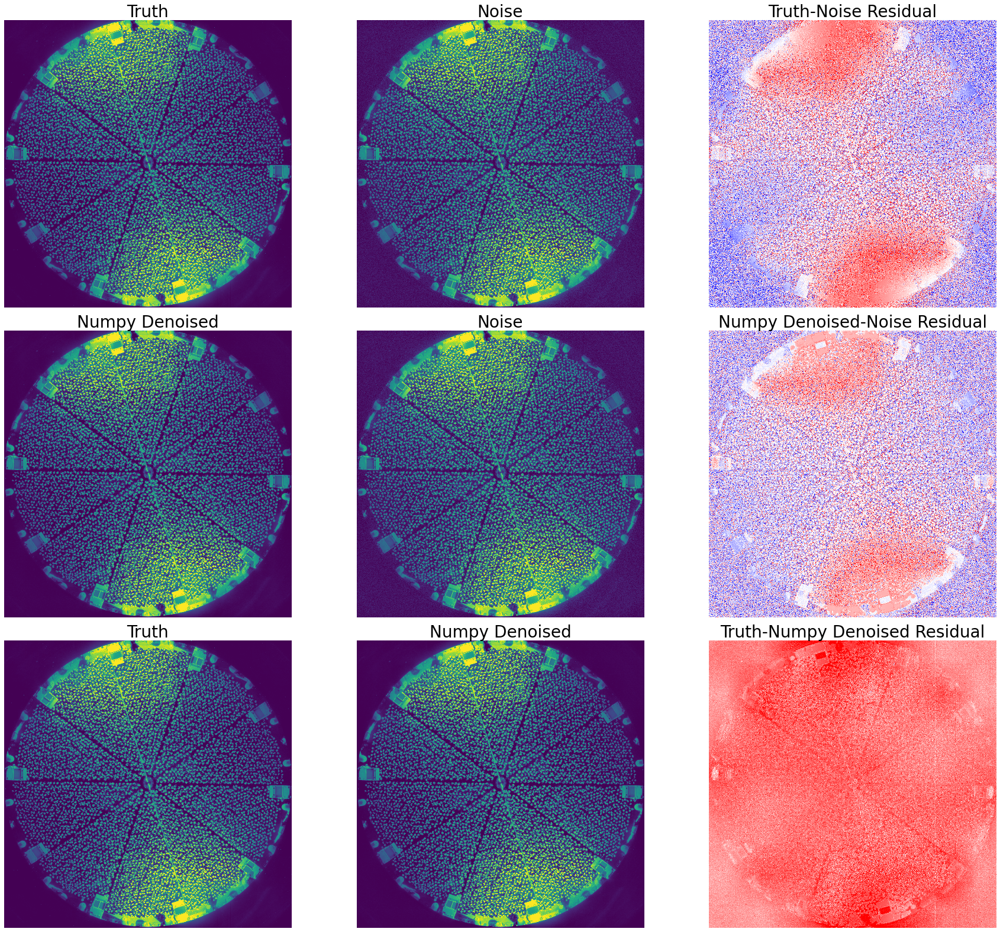

In [8]:
def np_full_pass_comparison(raw_data,
                    inf_data,
                    size,
                    x_start_idx,
                    y_start_idx):
    
    data_6k_raw = raw_data[0][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
    data_6k_truth = raw_data[1][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]

    full_img_inf = inf_data[0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
        
    
    fig, ax = plt.subplots(3, 3,figsize=(26, 22))
    
    # For 200x200 patches
    vmin, vmax = np.percentile(data_6k_raw, (1,99))
    # For full image
    vmin_full, vmax_full = np.percentile(raw_data[0][0][0], (1,99))
    # For residuals
    vmin_resid, vmax_resid = np.percentile((full_img_inf - data_6k_raw), (1,99))

    # Comparing noise vs. truth
    ax[0,0].imshow(data_6k_truth, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,0].axis('off')
    ax[0,0].set_title('Truth',fontsize=28) 
    ax[0,1].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,1].axis('off')
    ax[0,1].set_title('Noise',fontsize=28) 
    ax[0,2].imshow(data_6k_truth - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    ax[0,2].axis('off')
    ax[0,2].set_title('Truth-Noise Residual', fontsize=28)
  
    
    # Comparing Noise vs. Denoised
    ax[1,0].imshow(full_img_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[1,0].axis('off')
    ax[1,0].set_title('Numpy Denoised',fontsize=28)
    ax[1,1].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[1,1].axis('off')
    ax[1,1].set_title('Noise',fontsize=28) 
    ax[1,2].imshow(full_img_inf - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    ax[1,2].axis('off')
    ax[1,2].set_title('Numpy Denoised-Noise Residual', fontsize=28)
  
       
       
    # Comparing Denoised vs. Truth
    ax[2,0].imshow(data_6k_truth, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[2,0].axis('off')
    ax[2,0].set_title('Truth',fontsize=28) 
    ax[2,1].imshow(full_img_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[2,1].axis('off')
    ax[2,1].set_title('Numpy Denoised',fontsize=28) 
    ax[2,2].imshow(data_6k_truth - full_img_inf, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    ax[2,2].axis('off')
    ax[2,2].set_title('Truth-Numpy Denoised Residual', fontsize=28)
   
    

    fig.tight_layout()

np_full_pass_comparison(raw_data=test_data,
                inf_data=np_denoised_2k,
                size=6000,
                x_start_idx=0,
                y_start_idx=0)

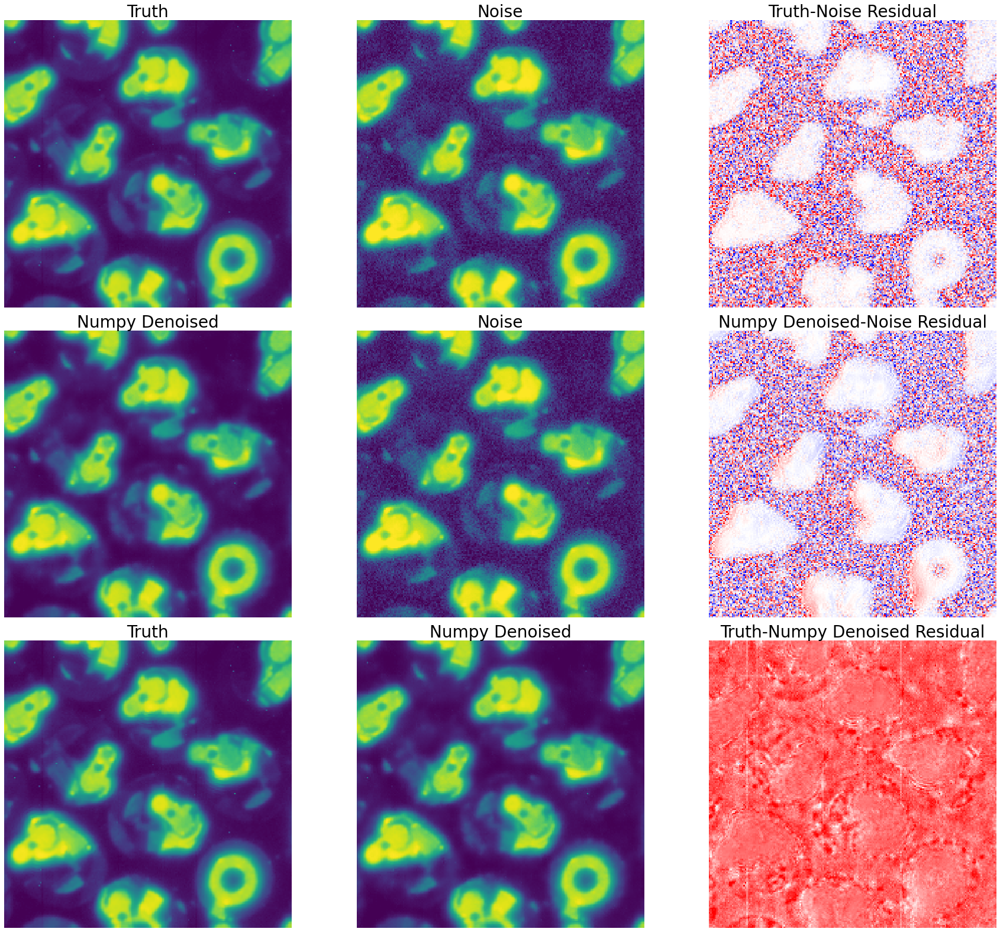

In [9]:
np_full_pass_comparison(raw_data=test_data,
                inf_data=np_denoised_2k,
                size=200,
                x_start_idx=4900,
                y_start_idx=3600)

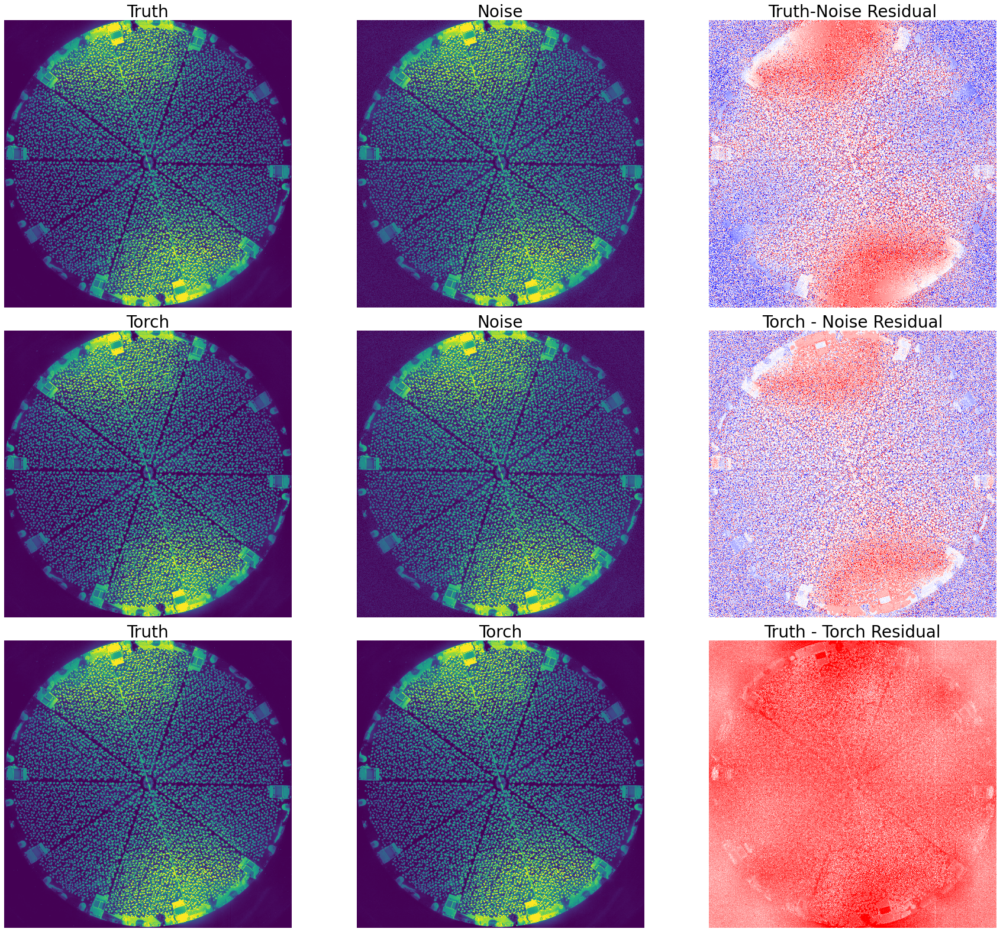

In [10]:
def torch_full_pass_comparison(raw_data,
                    inf_data,
                    size,
                    x_start_idx,
                    y_start_idx):
    
    data_6k_raw = raw_data[0][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
    data_6k_truth = raw_data[1][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]

    full_img_inf = inf_data[0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
        
    
    fig, ax = plt.subplots(3, 3,figsize=(26, 22))
    
    # For 200x200 patches
    vmin, vmax = np.percentile(data_6k_raw, (1,99))
    # For full image
    vmin_full, vmax_full = np.percentile(raw_data[0][0][0], (1,99))
    # For residuals
    vmin_resid, vmax_resid = np.percentile((full_img_inf - data_6k_raw), (1,99))

    # Comparing noise vs. truth
    ax[0,0].imshow(data_6k_truth, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,0].axis('off')
    ax[0,0].set_title('Truth',fontsize=28) 
    ax[0,1].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,1].axis('off')
    ax[0,1].set_title('Noise',fontsize=28) 
    ax[0,2].imshow(data_6k_truth - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    ax[0,2].axis('off')
    ax[0,2].set_title('Truth-Noise Residual', fontsize=28)
  
    
    # Comparing Noise vs. Denoised
    ax[1,0].imshow(full_img_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[1,0].axis('off')
    ax[1,0].set_title('Torch',fontsize=28)
    ax[1,1].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[1,1].axis('off')
    ax[1,1].set_title('Noise',fontsize=28) 
    ax[1,2].imshow(full_img_inf - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    ax[1,2].axis('off')
    ax[1,2].set_title('Torch - Noise Residual', fontsize=28)
  
       
       
    # Comparing Denoised vs. Truth
    ax[2,0].imshow(data_6k_truth, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[2,0].axis('off')
    ax[2,0].set_title('Truth',fontsize=28) 
    ax[2,1].imshow(full_img_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[2,1].axis('off')
    ax[2,1].set_title('Torch',fontsize=28) 
    ax[2,2].imshow(data_6k_truth - full_img_inf, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    ax[2,2].axis('off')
    ax[2,2].set_title('Truth - Torch Residual', fontsize=28)
   
    

    fig.tight_layout()

torch_full_pass_comparison(raw_data=test_data,
                inf_data=torch_denoised_2k[0],
                size=6000,
                x_start_idx=0,
                y_start_idx=0)

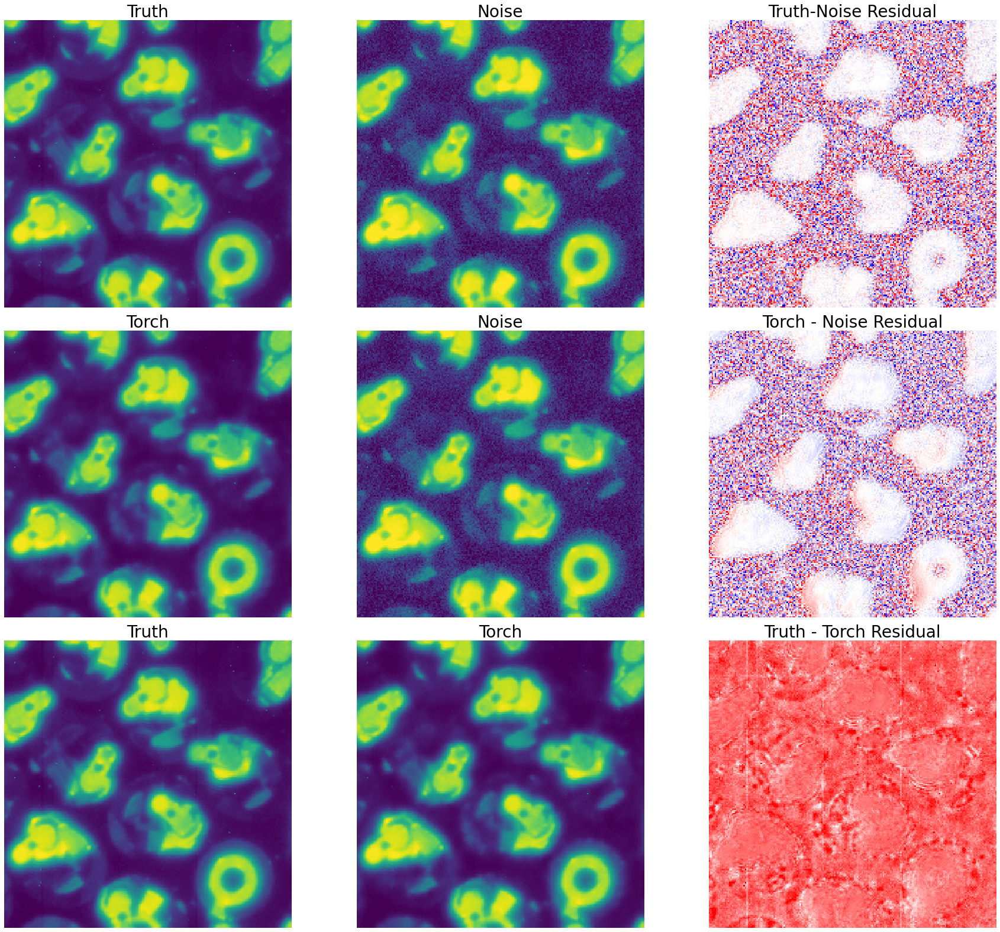

In [11]:
torch_full_pass_comparison(raw_data=test_data,
                inf_data=torch_denoised_2k[0],
                size=200,
                x_start_idx=4900,
                y_start_idx=3600)

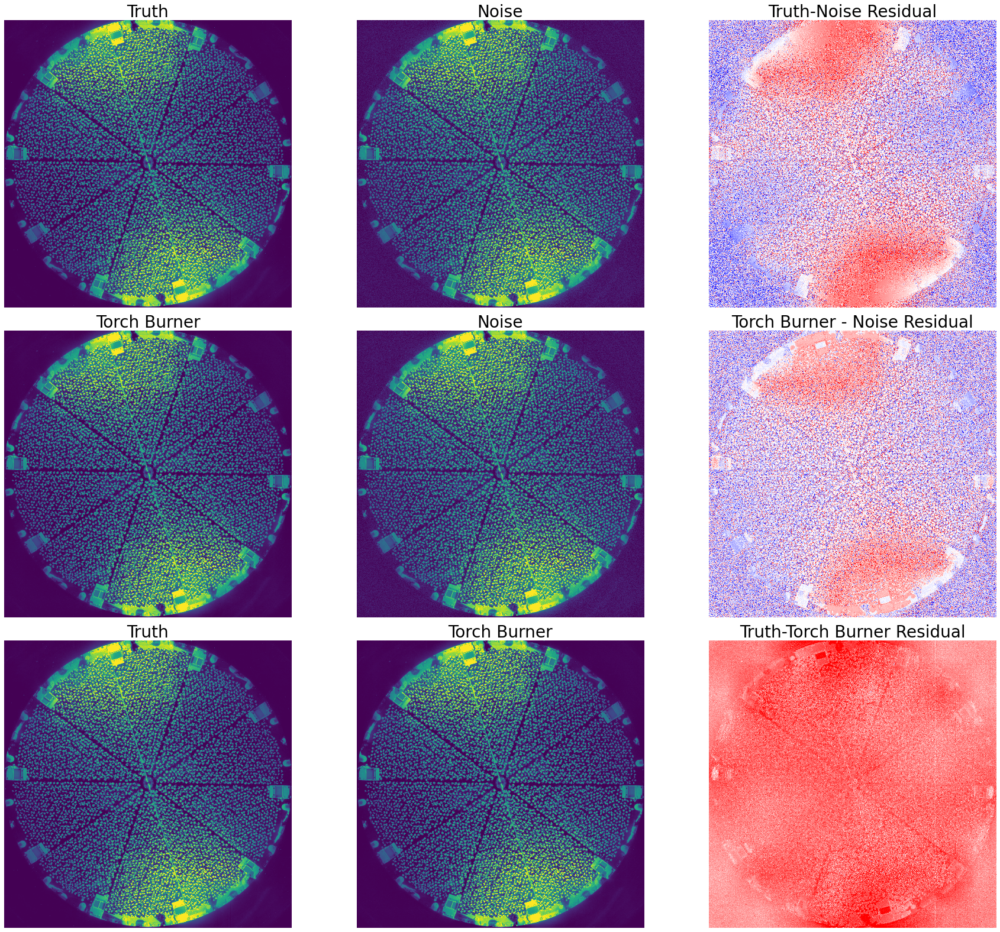

In [12]:
def afterburner_comparison(raw_data,
                    inf_data,
                    size,
                    x_start_idx,
                    y_start_idx):
    
    data_6k_raw = raw_data[0][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
    data_6k_truth = raw_data[1][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]

    full_img_inf = inf_data[0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
        
    
    fig, ax = plt.subplots(3, 3,figsize=(26, 22))
    
    # For 200x200 patches
    vmin, vmax = np.percentile(data_6k_raw, (1,99))
    # For full image
    vmin_full, vmax_full = np.percentile(raw_data[0][0][0], (1,99))
    # For residuals
    vmin_resid, vmax_resid = np.percentile((full_img_inf - data_6k_raw), (1,99))

    # Comparing noise vs. truth
    ax[0,0].imshow(data_6k_truth, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,0].axis('off')
    ax[0,0].set_title('Truth',fontsize=28) 
    ax[0,1].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,1].axis('off')
    ax[0,1].set_title('Noise',fontsize=28) 
    ax[0,2].imshow(data_6k_truth - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    ax[0,2].axis('off')
    ax[0,2].set_title('Truth-Noise Residual', fontsize=28)
  
    
    # Comparing Noise vs. Denoised
    ax[1,0].imshow(full_img_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[1,0].axis('off')
    ax[1,0].set_title('Torch Burner',fontsize=28)
    ax[1,1].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[1,1].axis('off')
    ax[1,1].set_title('Noise',fontsize=28) 
    ax[1,2].imshow(full_img_inf - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    ax[1,2].axis('off')
    ax[1,2].set_title('Torch Burner - Noise Residual', fontsize=28)
  
       
       
    # Comparing Denoised vs. Truth
    ax[2,0].imshow(data_6k_truth, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[2,0].axis('off')
    ax[2,0].set_title('Truth',fontsize=28) 
    ax[2,1].imshow(full_img_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[2,1].axis('off')
    ax[2,1].set_title('Torch Burner',fontsize=28) 
    ax[2,2].imshow(data_6k_truth - full_img_inf, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    ax[2,2].axis('off')
    ax[2,2].set_title('Truth-Torch Burner Residual', fontsize=28)
   
    

    fig.tight_layout()

afterburner_comparison(raw_data=test_data,
                inf_data=torch_afterburner,
                size=6000,
                x_start_idx=0,
                y_start_idx=0)

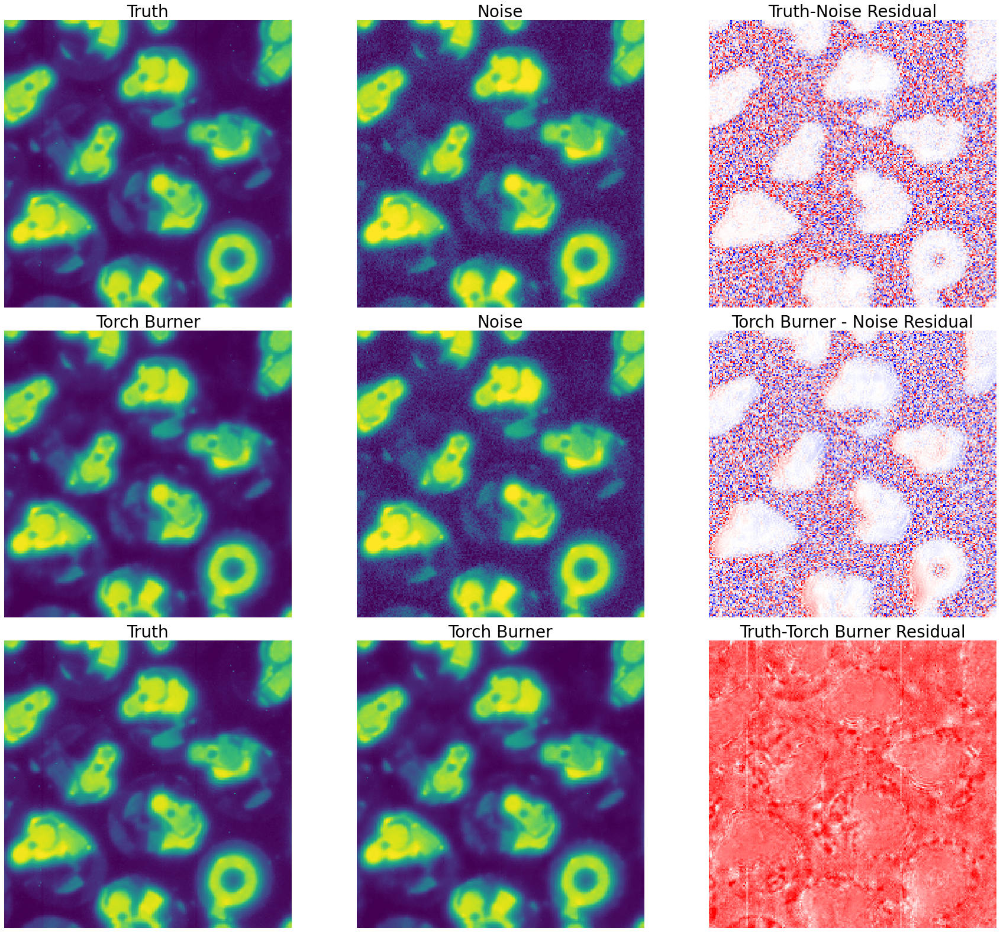

In [13]:
afterburner_comparison(raw_data=test_data,
                inf_data=torch_afterburner,
                size=200,
                x_start_idx=4900,
                y_start_idx=3600)

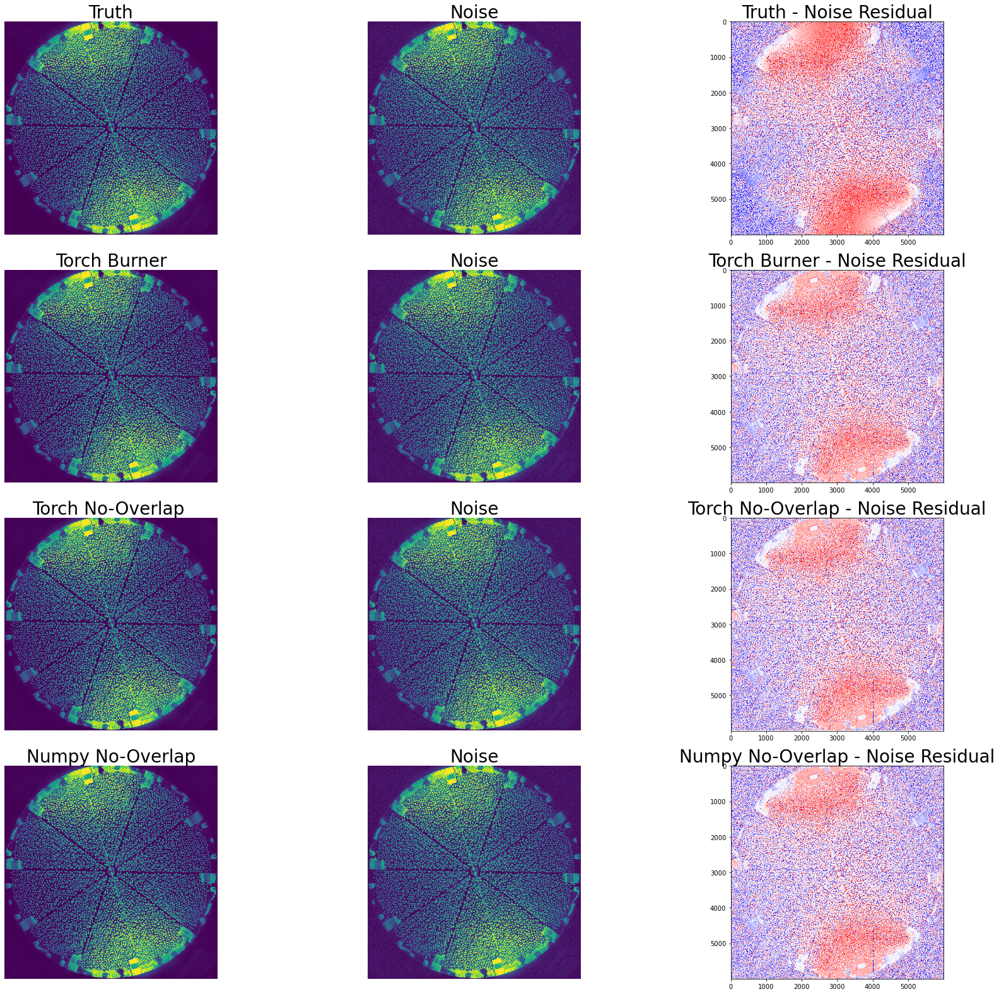

In [14]:
def algo_noise_comparison(raw_data,
                    np_data,
                    torch_data,
                    torch_afterburner_data,
                    size,
                    x_start_idx,
                    y_start_idx):
    
    # Getting 200x200 patches of the noisy/clean pairs
    data_6k_raw = raw_data[0][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
    data_6k_truth = raw_data[1][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]

    # Getting the same 200x200 patches of the noisy/clean pairs within the
    # 3 different denoised images we get from pytorc_full_pass, np_full_pass
    # and pytorch_afterburneer.
    np_inf = np_data[0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
    torch_inf = torch_data[0][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
    afterburner_inf = torch_afterburner_data[0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]

    
    fig, ax = plt.subplots(4, 3,figsize=(26, 22))
    
    # For 200x200 patches
    vmin, vmax = np.percentile(data_6k_raw, (1,99))
    # For full image
    vmin_full, vmax_full = np.percentile(raw_data[0][0][0], (1,99))
    # For residuals
    vmin_resid, vmax_resid = np.percentile((afterburner_inf - data_6k_raw), (1,99))

    # Comparing truth vs. noise 
    ax[0,0].imshow(data_6k_truth, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,0].axis('off')
    ax[0,0].set_title('Truth',fontsize=28) 
    ax[0,1].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,1].axis('off')
    ax[0,1].set_title('Noise',fontsize=28) 
    ax[0,2].imshow(data_6k_truth - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    # ax[0,2].axis('off')
    ax[0,2].set_title('Truth - Noise Residual', fontsize=28)
  
    
    # Comparing Torch Afterburner Denoised vs. Noise
    ax[1,0].imshow(afterburner_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[1,0].axis('off')
    ax[1,0].set_title('Torch Burner',fontsize=28)
    ax[1,1].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[1,1].axis('off')
    ax[1,1].set_title('Noise',fontsize=28) 
    ax[1,2].imshow(afterburner_inf - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    # ax[1,2].axis('off')
    ax[1,2].set_title('Torch Burner - Noise Residual', fontsize=28)
  
       
       
    # Comparing Torch Full Pass (ie. no overlapping patches) Denoised vs Noise
    ax[2,0].imshow(torch_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[2,0].axis('off')
    ax[2,0].set_title('Torch No-Overlap ',fontsize=28) 
    ax[2,1].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[2,1].axis('off')
    ax[2,1].set_title('Noise',fontsize=28) 
    ax[2,2].imshow(torch_inf - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    # ax[2,2].axis('off')
    ax[2,2].set_title('Torch No-Overlap - Noise Residual', fontsize=28)
    
    # Comparing Numpy Full Pass (ie. no overlapping patches) Denoised vs Noise
    ax[3,0].imshow(np_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[3,0].axis('off')
    ax[3,0].set_title('Numpy No-Overlap',fontsize=28) 
    ax[3,1].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[3,1].axis('off')
    ax[3,1].set_title('Noise',fontsize=28) 
    ax[3,2].imshow(np_inf - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    # ax[3,2].axis('off')
    ax[3,2].set_title('Numpy No-Overlap - Noise Residual', fontsize=28)
   
    

    fig.tight_layout()

algo_noise_comparison(raw_data=test_data,
                torch_afterburner_data=torch_afterburner,
                np_data=np_denoised_2k,
                torch_data=torch_denoised_2k,
                size=6000,
                x_start_idx=0,
                y_start_idx=0)

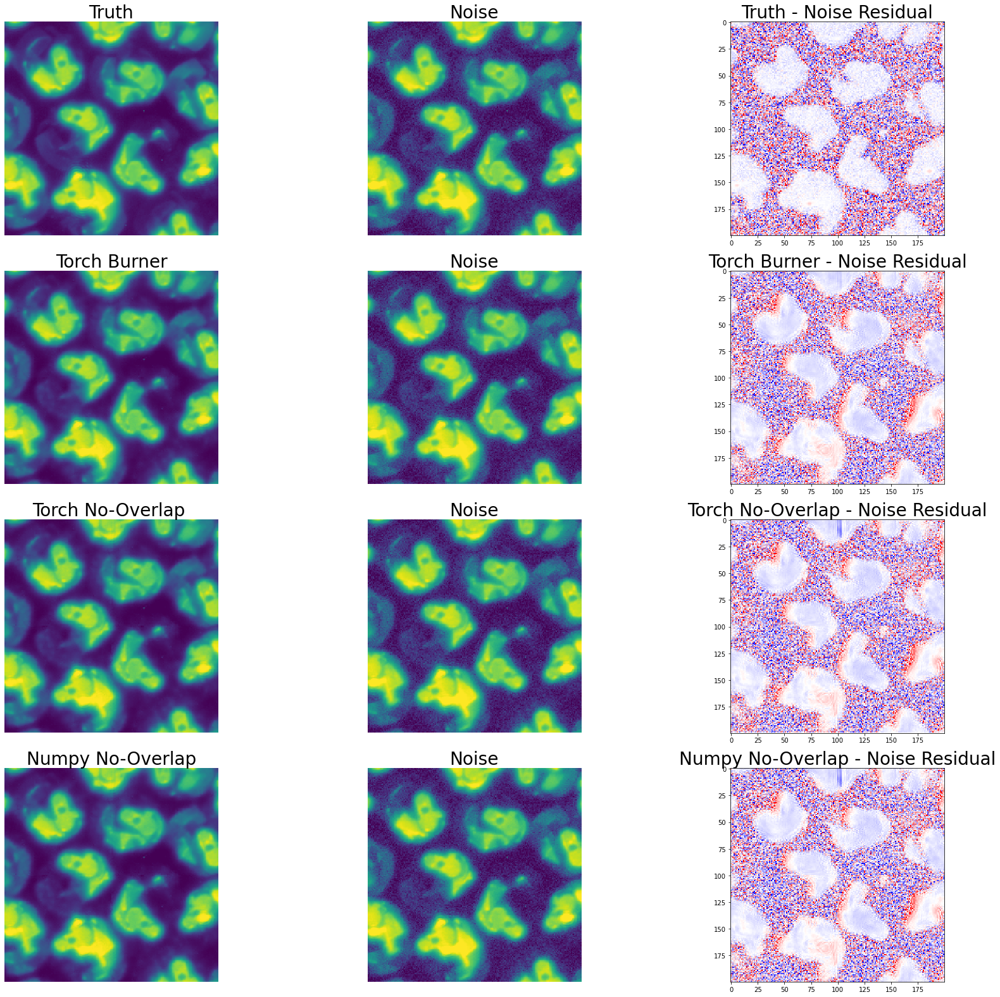

In [20]:
algo_noise_comparison(raw_data=test_data,
                torch_afterburner_data=torch_afterburner,
                np_data=np_denoised_2k,
                torch_data=torch_denoised_2k,
                size=200,
                x_start_idx=3900,
                y_start_idx=3900)

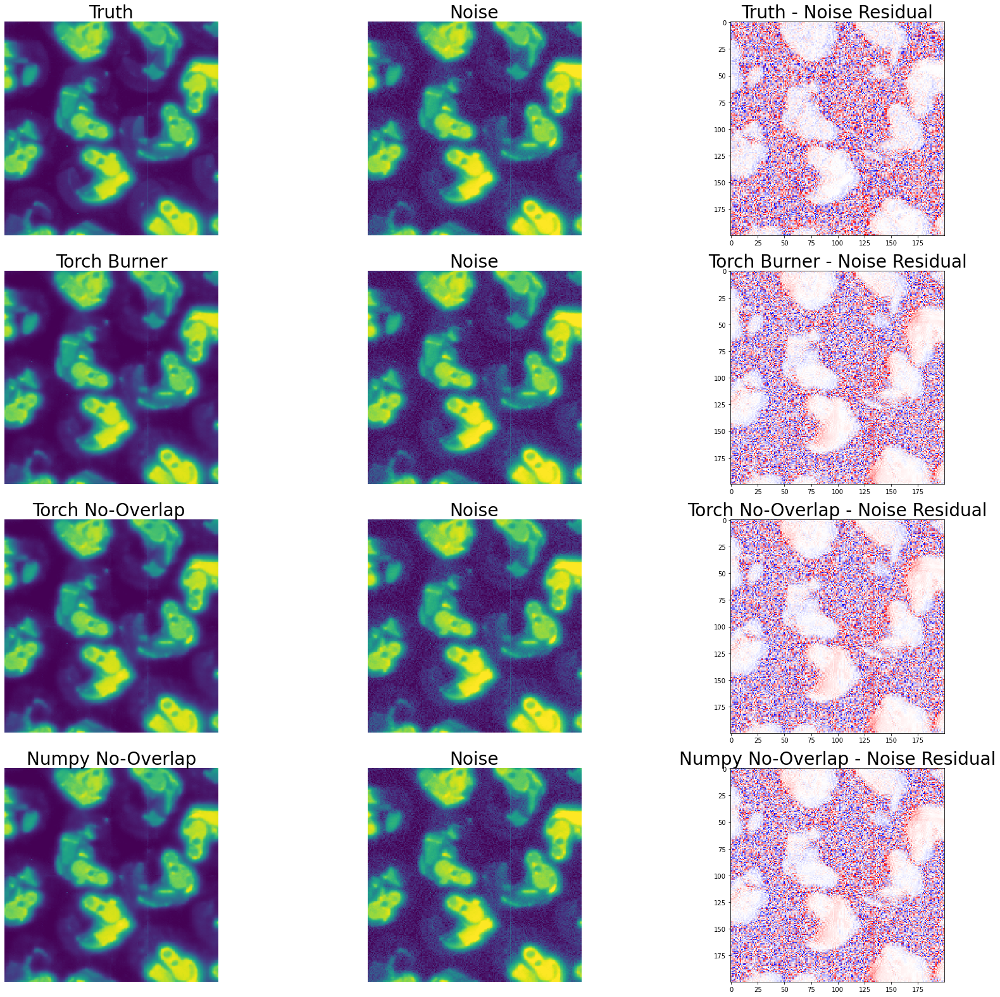

In [19]:
algo_noise_comparison(raw_data=test_data,
                torch_afterburner_data=torch_afterburner,
                np_data=np_denoised_2k,
                torch_data=torch_denoised_2k,
                size=200,
                x_start_idx=1900,
                y_start_idx=3900)

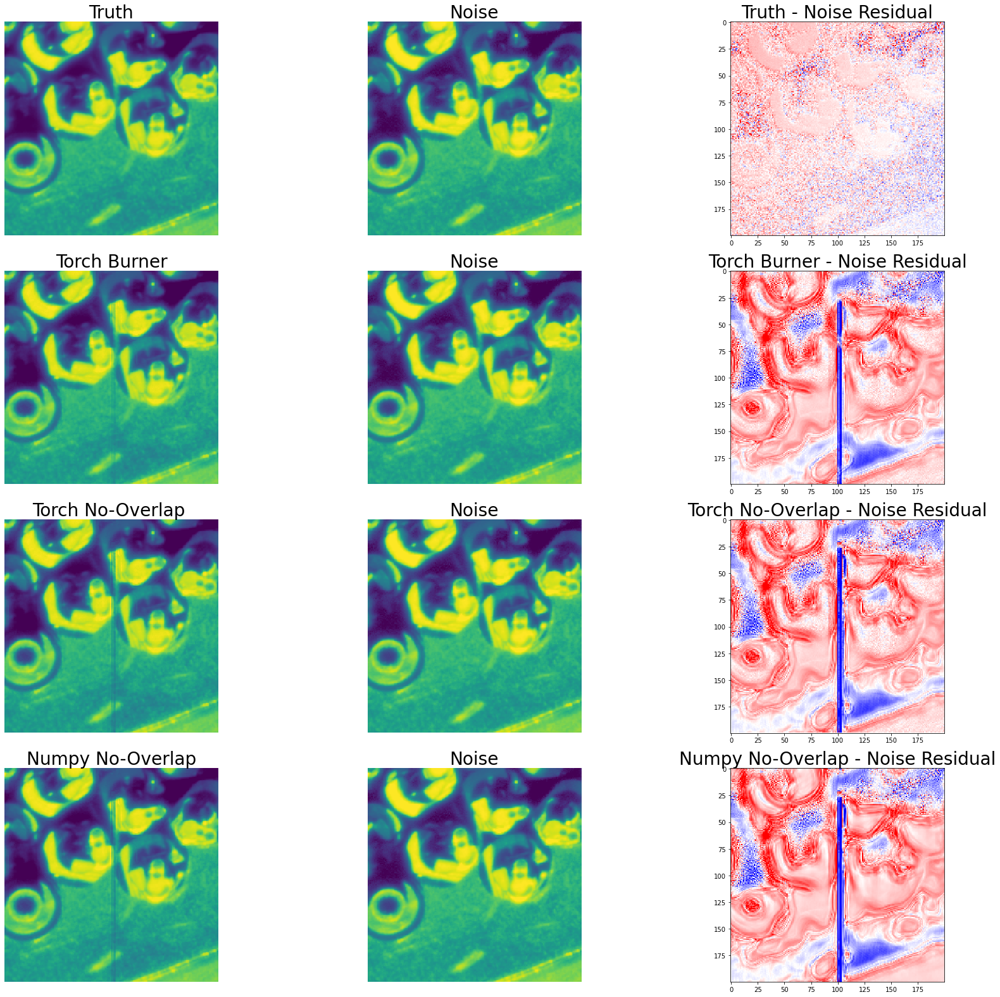

In [15]:
algo_noise_comparison(raw_data=test_data,
                torch_afterburner_data=torch_afterburner,
                np_data=np_denoised_2k,
                torch_data=torch_denoised_2k,
                size=200,
                x_start_idx=3900,
                y_start_idx=5500)

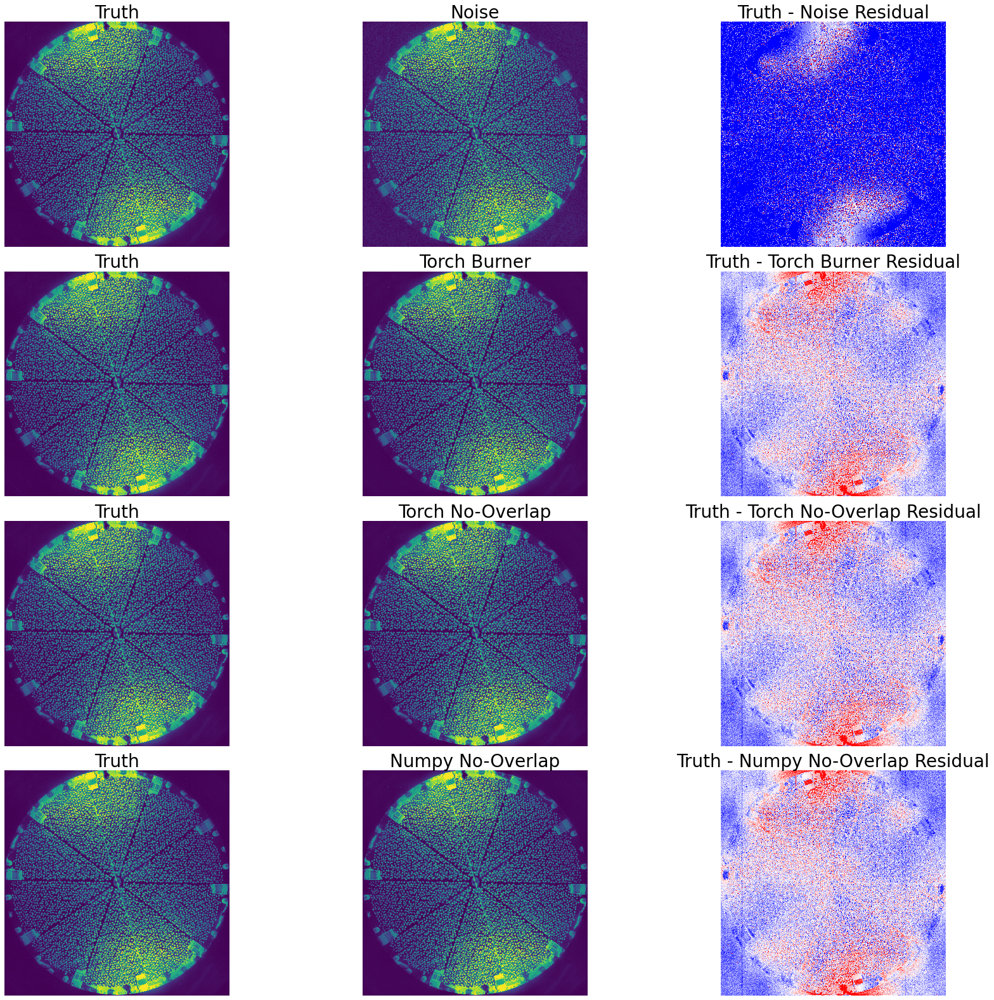

In [16]:
def algo_clean_comparison(raw_data,
                    np_data,
                    torch_data,
                    torch_afterburner_data,
                    size,
                    x_start_idx,
                    y_start_idx):
        
    
    # Getting 200x200 patches of the noisy/clean pairs
    data_6k_raw = raw_data[0][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
    data_6k_truth = raw_data[1][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]

    # Getting the same 200x200 patches of the noisy/clean pairs within the
    # 3 different denoised images we get from pytorc_full_pass, np_full_pass
    # and pytorch_afterburneer.
    np_inf = np_data[0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
    torch_inf = torch_data[0][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
    afterburner_inf = torch_afterburner_data[0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]

    # Getting residuals of truth vs. algorithim
    truth_after = data_6k_truth - afterburner_inf
    truth_torch = data_6k_truth - torch_inf
    truth_np = data_6k_truth - np_inf
    
    # For truth-afterburner residuals
    vmin_aft, vmax_aft = np.percentile(truth_after, (1,99))
    # For truth-torch residuals
    vmin_t, vmax_t = np.percentile(truth_torch, (1,99))
    # For truth-numpy residuals
    vmin_np, vmax_np = np.percentile(truth_np, (1,99))
    
    
    
    fig, ax = plt.subplots(4, 3,figsize=(26, 22))
    
    # For 200x200 patches
    vmin, vmax = np.percentile(data_6k_truth, (1,99))
    # For full image
    vmin_full, vmax_full = np.percentile(raw_data[1][0][0], (1,99))
    # For residuals
    vmin_resid, vmax_resid = np.percentile((data_6k_truth- afterburner_inf), (1,99))

    # Comparing truth vs. noise 
    ax[0,0].imshow(data_6k_truth, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,0].axis('off')
    ax[0,0].set_title('Truth',fontsize=28) 
    ax[0,1].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,1].axis('off')
    ax[0,1].set_title('Noise',fontsize=28) 
    ax[0,2].imshow(data_6k_truth - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    ax[0,2].axis('off')
    ax[0,2].set_title('Truth - Noise Residual', fontsize=28)
  
    
    # Comparing Torch Afterburner Denoised vs. Noise
    ax[1,0].imshow(data_6k_truth, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[1,0].axis('off')
    ax[1,0].set_title('Truth',fontsize=28)
    ax[1,1].imshow(afterburner_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[1,1].axis('off')
    ax[1,1].set_title('Torch Burner',fontsize=28) 
    ax[1,2].imshow(data_6k_truth - afterburner_inf, vmin=vmin_aft, vmax=vmax_aft, cmap='bwr', origin='upper', interpolation='none')
    ax[1,2].axis('off')
    ax[1,2].set_title('Truth - Torch Burner Residual', fontsize=28)
  
       
       
    # Comparing Torch Full Pass (ie. no overlapping patches) Denoised vs Noise
    ax[2,0].imshow(data_6k_truth, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[2,0].axis('off')
    ax[2,0].set_title('Truth',fontsize=28) 
    ax[2,1].imshow(torch_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[2,1].axis('off')
    ax[2,1].set_title('Torch No-Overlap',fontsize=28) 
    ax[2,2].imshow(data_6k_truth - torch_inf, vmin=vmin_t, vmax=vmax_t, cmap='bwr', origin='upper', interpolation='none')
    ax[2,2].axis('off')
    ax[2,2].set_title('Truth - Torch No-Overlap Residual', fontsize=28)
    
    # Comparing Numpy Full Pass (ie. no overlapping patches) Denoised vs Noise
    ax[3,0].imshow(data_6k_truth, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[3,0].axis('off')
    ax[3,0].set_title('Truth',fontsize=28) 
    ax[3,1].imshow(np_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[3,1].axis('off')
    ax[3,1].set_title('Numpy No-Overlap',fontsize=28) 
    ax[3,2].imshow(data_6k_truth - np_inf, vmin=vmin_np, vmax=vmax_np, cmap='bwr', origin='upper', interpolation='none')
    ax[3,2].axis('off')
    ax[3,2].set_title('Truth - Numpy No-Overlap Residual', fontsize=28)
   
    

    fig.tight_layout()

algo_clean_comparison(raw_data=test_data,
                torch_afterburner_data=torch_afterburner,
                np_data=np_denoised_2k,
                torch_data=torch_denoised_2k,
                size=6000,
                x_start_idx=0,
                y_start_idx=0)

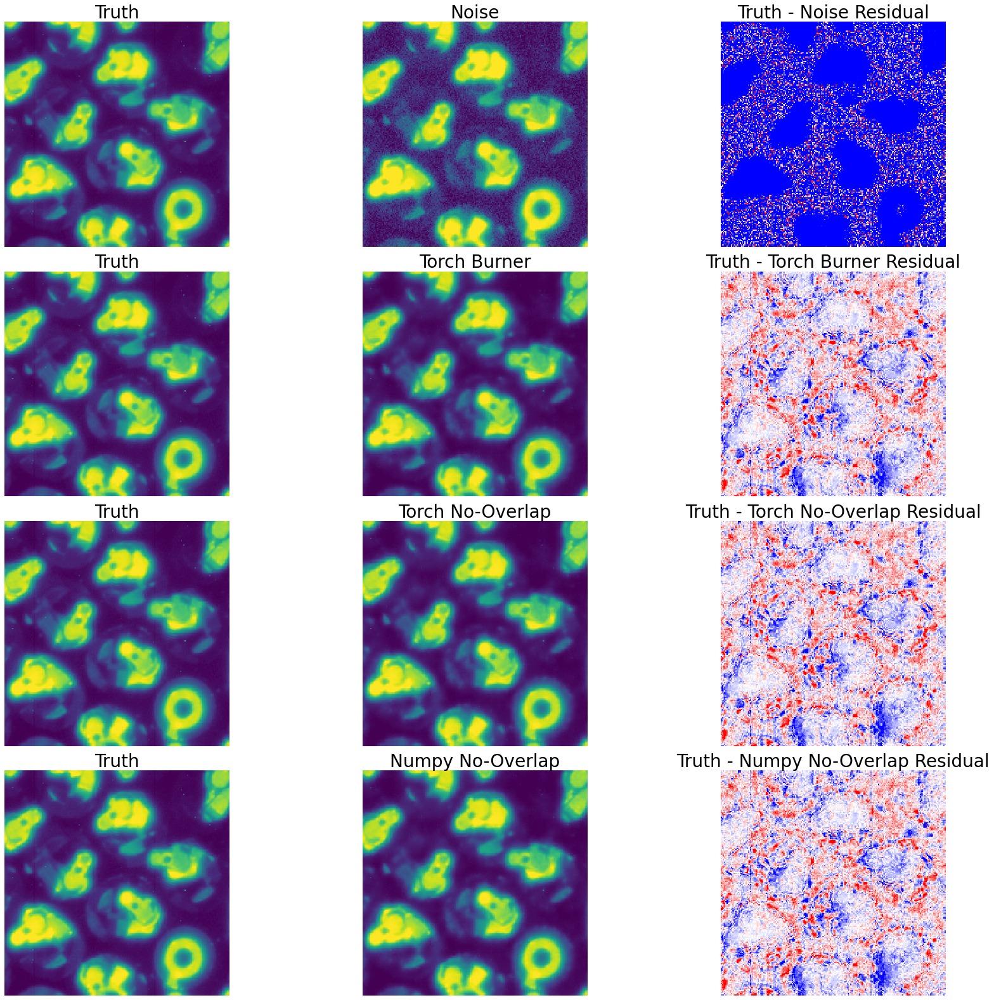

In [17]:
algo_clean_comparison(raw_data=test_data,
                torch_afterburner_data=torch_afterburner,
                np_data=np_denoised_2k,
                torch_data=torch_denoised_2k,
                size=200,
                x_start_idx=4900,
                y_start_idx=3600)

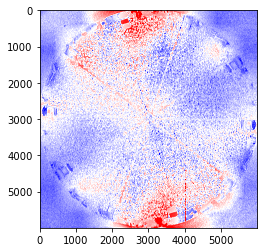

In [18]:
residual = test_data[1][0] - torch_denoised_2k[0]

vmin_resid, vmax_resid = np.percentile(residual, (1,99))

plt.imshow(residual[0][0], vmin=vmin_resid, vmax=vmax_resid, cmap='bwr')